# easy_text_clustering Example Workflow

## Basic Usage

First we can import the libraries, load the dataset and run the basic optimize_fit pipeline. I set summary_create to False because I don't need to generate cluster summaries at this point. Note that the show method may give an error message when run without cluster summaries, but that this does not prevent it from running correctly.

INFO:sentence_transformers.SentenceTransformer:Load pretrained SentenceTransformer: all-MiniLM-L6-v2


Batches:   0%|          | 0/1563 [00:00<?, ?it/s]

[I 2024-12-09 16:38:15,040] A new study created in memory with name: no-name-65c091b6-39c3-4577-9585-cbc2095d2d26
[I 2024-12-09 16:41:22,283] Trial 0 finished with value: 1.4318164081291451 and parameters: {'umap_n_neighbors': 13, 'umap_min_dist': 0.641799695115944, 'hdbscan_min_cluster_size': 56, 'cluster_selection_epsilon': 0.8101333802893501}. Best is trial 0 with value: 1.4318164081291451.
[I 2024-12-09 16:44:01,935] Trial 1 finished with value: 1.9672124668026796 and parameters: {'umap_n_neighbors': 9, 'umap_min_dist': 0.5979143461745817, 'hdbscan_min_cluster_size': 42, 'cluster_selection_epsilon': 0.7757519743788995}. Best is trial 1 with value: 1.9672124668026796.
[I 2024-12-09 16:46:37,638] Trial 2 finished with value: 1.9060513136153836 and parameters: {'umap_n_neighbors': 7, 'umap_min_dist': 0.6282452991280053, 'hdbscan_min_cluster_size': 51, 'cluster_selection_epsilon': 0.2609851283773288}. Best is trial 1 with value: 1.9672124668026796.
[I 2024-12-09 16:49:16,720] Trial 3 f

Using HDBSCAN params={'cluster_selection_method': 'leaf', 'min_cluster_size': 88, 'metric': 'euclidean', 'cluster_selection_epsilon': 0.10118407166523646}


AttributeError: 'NoneType' object has no attribute 'keys'

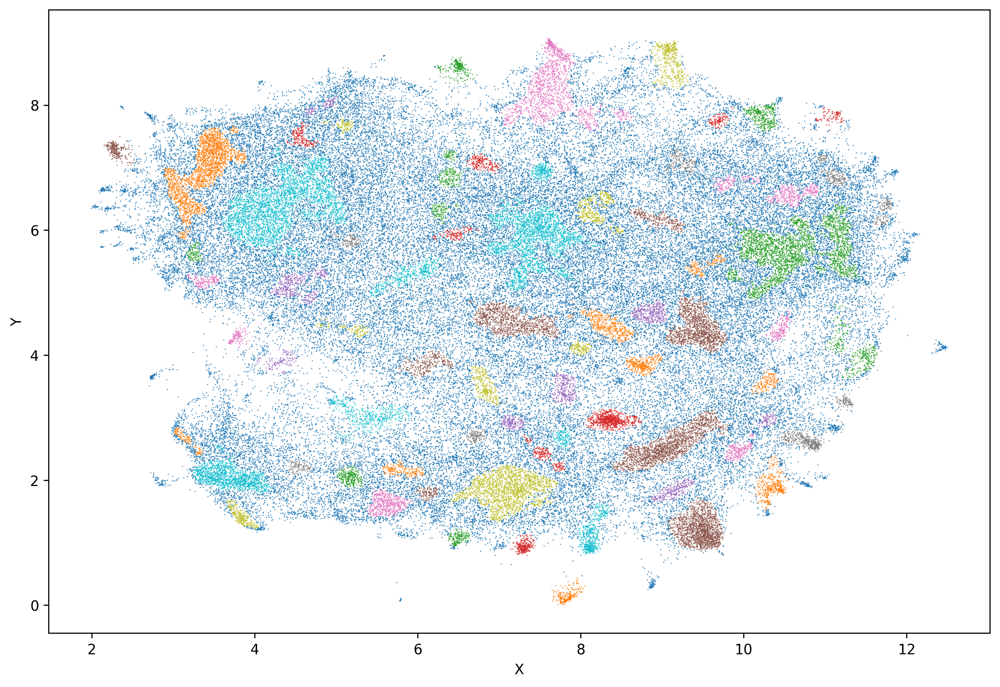

In [1]:
from easy_text_clustering.clusterer import ClusterClassifier
from datasets import load_dataset

SAMPLE = 100_000 # select the number of samples from the data that you'd like to use

texts = load_dataset("openpecha/cleaned_MT_v1.0.3", split="train").select(range(SAMPLE))["Target"]

cc = ClusterClassifier(embed_device='cuda', summary_create=False)

# Perform optimization and fitting
cc.optimize_fit(texts=texts)

cc.show()

### Generate Cluster Summaries

This set of clusters is not too bad, so I'll generate summaries for them.

In [5]:
cc.cluster_summaries = cc.summarize(texts=cc.texts, labels=cc.cluster_labels)

Request:
<s>[INST]Example 1:
I’m a yogi who has attained mastery over prana and mind. Since I have overcome the constituents of the four elements, I can display miracles of transforming my body into anything I desire.

Example 2:
I am an abandoned yogi, who eats for food The inner Samadhi of Non discernment.

Example 3:
In this way a yogi should meditate on the precious suchness devoid of the eighteen constituents.

Example 4:
Since a host of awakened Masters encircle him And a multitude of great yogins pay their homage.

Example 5:
“Benefactors, I am a yogi and have come here seeking today’s provisions.”

Example 6:
So saying, he drew his razor sharp knife, and, pressing the point against his heart, sang: Listen to me, Revered Yogi, On this auspicious morning, while riding on my way, I saw a naked man, lying beside a silver spring.

Example 7:
Bon" will help, and divination too; Thus, I, the Yogi, will divine for you.

Example 8:
As for "realize," that becomes manifest to the yogi/ni.

### Inspect Summary Results

Now I can see what these results look like with the summaries.

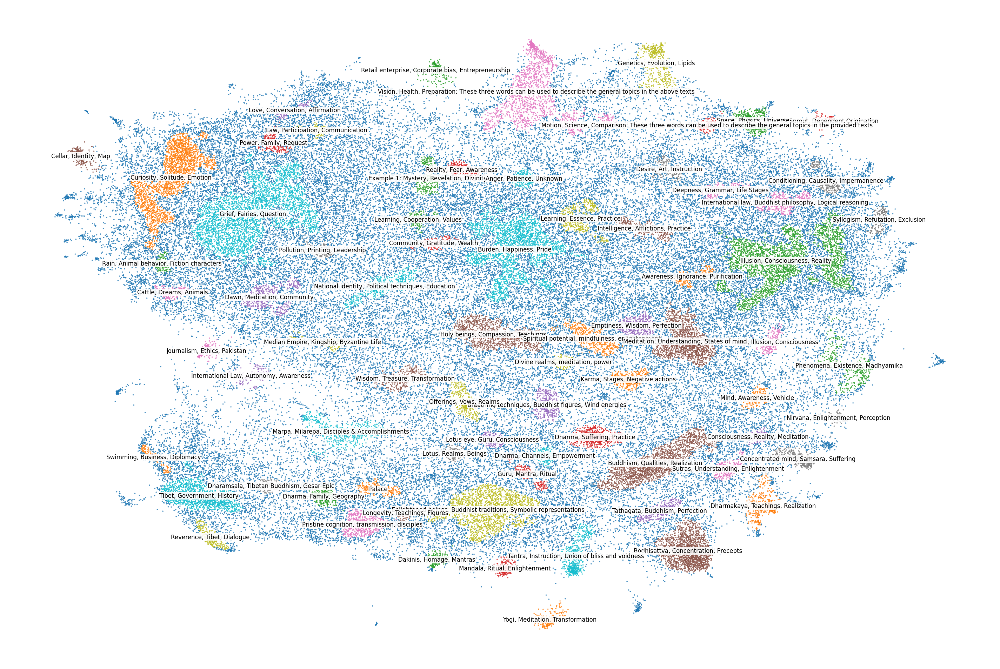

In [6]:
cc.show()

## Refining Results

Now that we have summaries, its easier to see that these clusters are a little too small, with a too much redundancy. To fix this, I can update my clustering arguments with a larger cluster_selection_epsilon in order to fuse some of the clusters.

### Inspect Existing Clustering Hyperparameters

Below, I've printed the clustering hyperparameters that the pipeline is using.

In [7]:
cc.clustering_args

{'cluster_selection_method': 'leaf',
 'min_cluster_size': 88,
 'metric': 'euclidean',
 'cluster_selection_epsilon': 0.10118407166523646}

### Try Updating Hyperparameters

Now, I run the fit method without optimization, passing an updated version of the clustering_args. I can iterate on this process as many times as I'd like to refine my results.

INFO:root:Using precomputed embeddings...
INFO:root:Building FAISS index...
INFO:root:Using precomputed projections...
INFO:root:Clustering...


Using HDBSCAN params={'cluster_selection_method': 'leaf', 'min_cluster_size': 88, 'metric': 'euclidean', 'cluster_selection_epsilon': 0.12}


AttributeError: 'NoneType' object has no attribute 'keys'

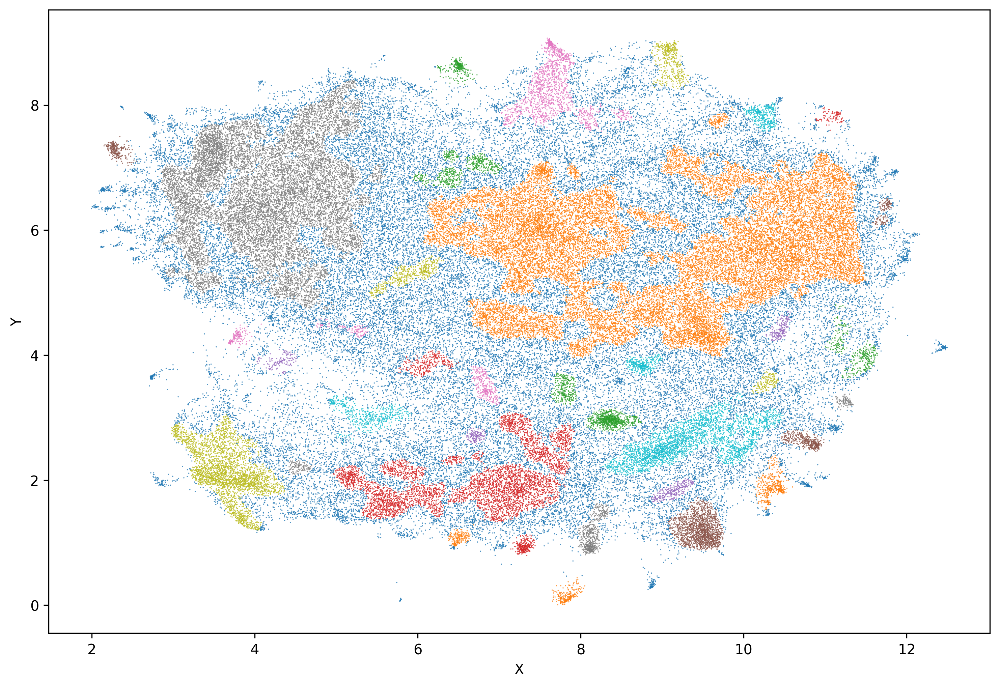

In [10]:
cc.fit(clustering_args={'cluster_selection_method': 'leaf',
 'min_cluster_size': 88,
 'metric': 'euclidean',
 'cluster_selection_epsilon': 0.12})

cc.show()

### Update Cluster Summaries

Now that I'm happy with my updated hyperparameters, I can regenerate the cluster summaries to reflect the updated clusters. Note that the output will also give me a count of the number of clusters.

Request:
<s>[INST]Example 1:
A yogin should always meditate On the mind of awakening, which is luminosity.

Example 2:
9. Tranquility With respect to that, first of all, in order to stabilize the mind, the yogī should become established in tranquility.

Example 3:
For yogis who have realized that phenomena are the illusion-like self-experience of awareness, whatever appears the objects of the six consciousnesses, which are no more than awareness experiencing itself arises in the very moment of its being perceived as the display of what does not exist.

Example 4:
The graduations of refuter Worldly people and non Buddhists grasp many tiny atoms as a composite whole and take the stream of instants of cognition as a unified continuity. Since they are grasping at permanence, worldly yogins are opposed to them. These are śrāvakas who, with lower conceptual thought, have established tiny atoms and momentary instants of grasping.

Example 5:
Investigating in that manner, when the yogī does 

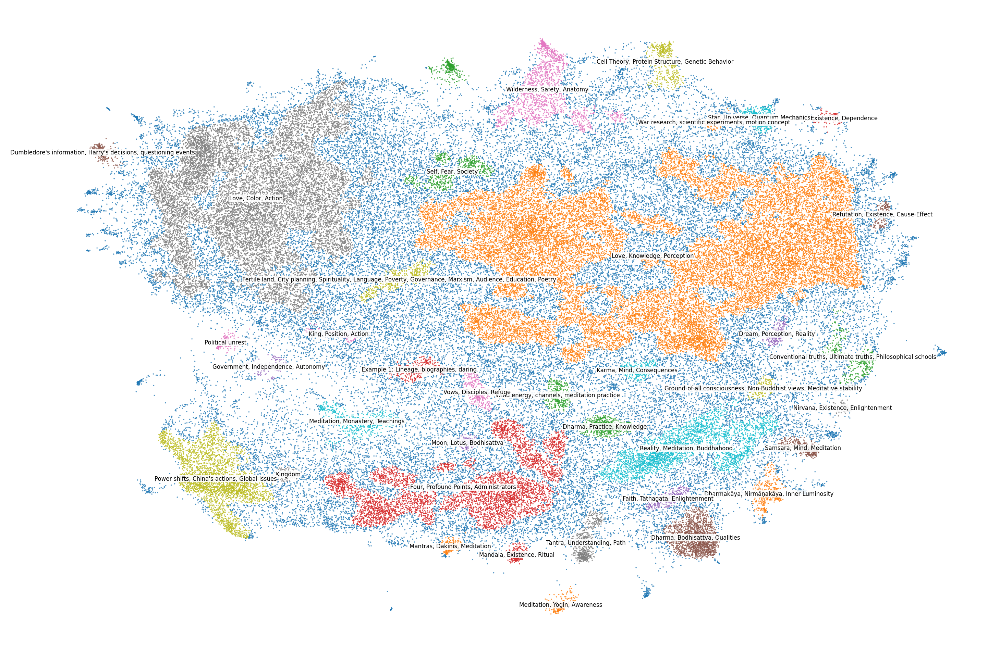

In [11]:
cc.cluster_summaries = cc.summarize(texts=cc.texts, labels=cc.cluster_labels)
cc.show()

## Optimizing Results Without Fitting

Above, I have 39 clusters. I might be content with that number, but now that I've adjusted the hyperparameters I may no longer be convinced that this is the best way to get that number of clusters. 

I can separate out the optimization process and run it on its own, pre-determining the number of clusters that I'm hoping to find. Here, I've tried between 20 and 30 clusters to see what I get. I've also limited the number of optimization trials to 25. 

This will return a set of hyperparameters for the projection and clustering steps.

In [17]:
from easy_text_clustering.optimizer import Optimizer

opt = Optimizer(min_clusters=20, max_clusters=30)

projection_args, clustering_args= opt.fit(cc.embeddings, optimization_trials=25)

[I 2024-12-09 17:47:51,373] A new study created in memory with name: no-name-a41b5df8-08d1-4658-b762-1b6161a75d91
[I 2024-12-09 17:50:19,685] Trial 0 finished with value: -16.889488835412862 and parameters: {'umap_n_neighbors': 13, 'umap_min_dist': 0.1873057187709085, 'hdbscan_min_cluster_size': 43, 'cluster_selection_epsilon': 0.3988069552449687}. Best is trial 0 with value: -16.889488835412862.
[I 2024-12-09 17:52:28,636] Trial 1 finished with value: -17.740958655292978 and parameters: {'umap_n_neighbors': 5, 'umap_min_dist': 0.3244413423971516, 'hdbscan_min_cluster_size': 40, 'cluster_selection_epsilon': 0.9470739308070011}. Best is trial 0 with value: -16.889488835412862.
[I 2024-12-09 17:54:45,608] Trial 2 finished with value: -18.181285255122447 and parameters: {'umap_n_neighbors': 13, 'umap_min_dist': 0.5333597973738673, 'hdbscan_min_cluster_size': 63, 'cluster_selection_epsilon': 0.7076939257875567}. Best is trial 0 with value: -16.889488835412862.
[I 2024-12-09 17:57:14,683] T

### Fit With Optimized Hyperparameters

I can now pass those hyperparameters to the fit method of my ClusterClassifier and inspect the results. Note that, unfortunately, in just 25 trials, the optimizer was not able to find a satisfactory clustering in the range that I specified. I could re-run with more optimization trials, or return to the hyperparameters that I liked earlier.

INFO:root:Using precomputed embeddings...
INFO:root:Building FAISS index...
INFO:root:Using precomputed projections...
INFO:root:Clustering...


Using HDBSCAN params={'cluster_selection_method': 'leaf', 'min_cluster_size': 99, 'metric': 'euclidean', 'cluster_selection_epsilon': 0.006772888977944551}


INFO:root:Summarizing cluster centers...


Request:
<s>[INST]Example 1:
Therein, at the outset, for achievement of success in tranquility and insight quicky and easily, the yogī should now devote himself to the accumulation of the prerequisites of tranquility and insight.

Example 2:
It is so that the yogī will correctly discern the characteristics of the messengers.

Example 3:
To yogins who practice indivisible unity, from the ground of being the expression of emptiness arises as interdependence, which in turn is an unceasing illusion free from extremes.

Example 4:
And guard us yogins against obstacles to practice!

Example 5:
Furthermore, completing common familiarization practice - the four vajras, the sense faculties of the yogi/ni who enters the supreme familiarization practice do indeed enjoy objects, but just this alone is not the path of "retraction" meditation, because that must be posited as for the mental consciousness itself alone.

Example 6:
Is there a noble yogi who knows that the sixfold collection of conscio

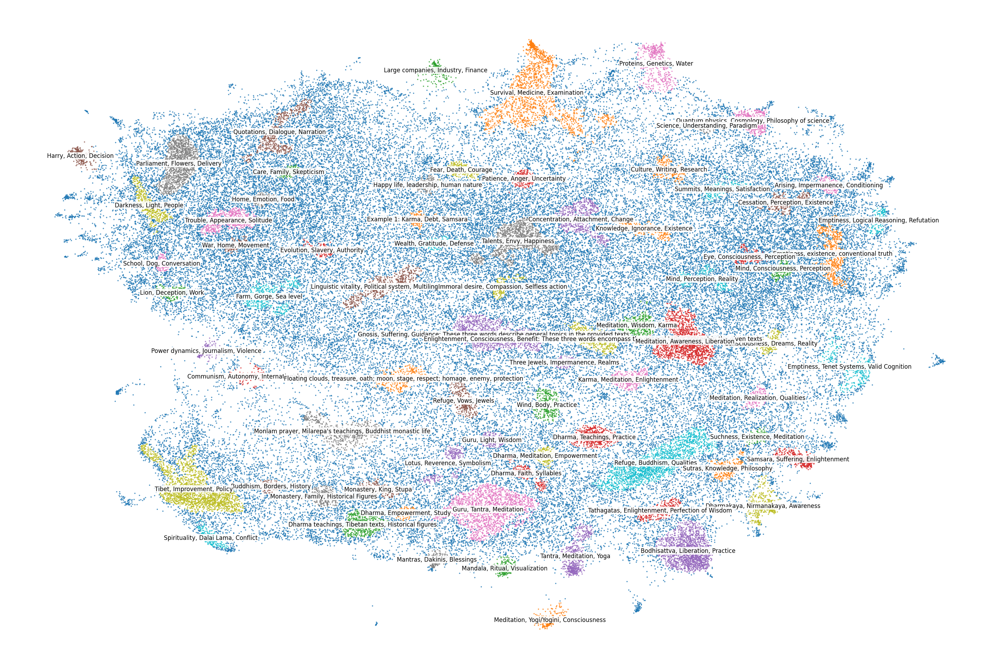

In [18]:
cc.summary_create = True
cc.fit(projection_args=projection_args, clustering_args=clustering_args)
cc.show()

## Closer Inspection of Clusters

Once you're content with the clustering, you can more closely inspect the clusters and their contents. First, I'll just print out the cluster_summaries. Most of them are pretty informative but a few seem problematic. Notably, cluster 4 includes the name 'Harry', which seems peculiar relative to the rest of the subject matter.

In [21]:
cc.cluster_summaries

{-1: 'None',
 0: 'Meditation, Yogi/Yogini, Consciousness',
 1: 'Large companies, Industry, Finance',
 2: 'Communism, Autonomy, International Law',
 3: 'Power dynamics, Journalism, Violence',
 4: 'Harry, Action, Decision',
 5: 'Proteins, Genetics, Water',
 6: "Monlam prayer, Milarepa's teachings, Buddhist monastic life",
 7: 'Dharmakaya, Nirmanakaya, Awareness',
 8: 'Emptiness, Tenet Systems, Valid Cognition',
 9: 'Survival, Medicine, Examination',
 10: 'Mandala, Ritual, Visualization',
 11: 'Tathagatas, Enlightenment, Perfection of Wisdom',
 12: 'Bodhisattva, Liberation, Practice',
 13: 'Buddhism, Borders, History',
 14: 'Quantum physics, Cosmology, Philosophy of science',
 15: 'Science, Understanding, Paradigm',
 16: 'Tibet, Improvement, Policy',
 17: 'Spirituality, Dalai Lama, Conflict',
 18: 'Floating clouds, treasure, oath; moon, stage, respect; homage, enemy, protection',
 19: 'Wind, Body, Practice',
 20: 'Samsara, Suffering, Enlightenment',
 21: 'Tantra, Meditation, Yoga',
 22: '

### Inspecting a Cluster

I can look at the indexes for a given cluster using the code below. For example, if it outputs [333, ...], then texts[333] is in this cluster. Then, I can show the texts in the cluster using the next code cell.

In [24]:
cc.label2docs[4]

[318,
 447,
 809,
 1014,
 1389,
 1812,
 1837,
 2310,
 2323,
 2671,
 2758,
 3036,
 3138,
 3440,
 3495,
 3545,
 4259,
 6338,
 7239,
 7706,
 7893,
 8108,
 9119,
 9347,
 9823,
 9902,
 10113,
 10127,
 10940,
 11505,
 11569,
 12104,
 12419,
 12764,
 12871,
 13928,
 15034,
 15321,
 16365,
 16404,
 16531,
 16622,
 16624,
 16715,
 17358,
 17741,
 17973,
 18247,
 18570,
 18911,
 19467,
 19700,
 20622,
 20786,
 20998,
 21328,
 22219,
 22363,
 22611,
 23271,
 23303,
 23512,
 24504,
 24791,
 25253,
 25464,
 26048,
 26601,
 27061,
 27437,
 27848,
 27875,
 28618,
 28896,
 29020,
 29249,
 30160,
 30408,
 30686,
 30907,
 31266,
 31349,
 31550,
 31933,
 32132,
 32635,
 32761,
 32854,
 32938,
 33521,
 35378,
 35438,
 35810,
 36034,
 36511,
 36709,
 36882,
 37225,
 37744,
 37819,
 38069,
 38283,
 40271,
 41475,
 41493,
 41949,
 42013,
 42352,
 42669,
 43164,
 43586,
 44378,
 44394,
 44505,
 44545,
 44713,
 45321,
 45586,
 46031,
 46090,
 46588,
 47488,
 47713,
 49585,
 49863,
 50086,
 50114,
 50965,
 5116

In [23]:
[cc.texts[_] for _ in cc.label2docs[4]]

['Hermione, gasping for breath, her lip bleeding, scrambled aside, snatching up her and Ron’s wands.',
 'I have never hurt a hair of Harry’s head!',
 'Yeah,’ said Harry, looking at his own watch.',
 'Right in the middle of the picture was Ron, tall and gangling, with his pet rat Scabbers on his shoulder and his arm around his little sister, Ginny. Harry couldn’t think of anyone who deserved to win a large pile of gold more than the Weasleys, who were very nice and extremely poor. He picked up Ron’s letter and unfolded it. Dear Harry, Happy birthday! Look, I’m really sorry about that telephone call. I hope the Muggles didn’t give you a hard time. I asked Dad, and he reckons I shouldn’t have shouted. It’s brilliant here in Egypt. Bill’s taken us round all the tombs and you wouldn’t believe the curses those old Egyptian wizards put on them. Mum wouldn’t let Ginny come in the last one. There were all these mutant skeletons in there, of Muggles who’d broken in and grown extra heads and stuf

### Fixing Cluster Summary

The texts above are clearly sentences from the Harry Potter series of novels. Since I want that to be immediately obvious in my visualization, I can change the summary for that cluster using the code below. First, I confirm that I'm working with the correct cluster label (4) then I update the summary for that label.

In [ ]:
cc.cluster_summaries[4] 

'Harry, Action, Decision'

In [26]:
cc.cluster_summaries[4] = 'Harry Potter'
cc.cluster_summaries[4] 

'Harry Potter'

## Saving Results

I can now save the cluster classifier and its results to a folder of my choosing. Below, I have named the folder 'my-clustering-results'. 

In [ ]:
cc.save('my-clustering-results')

## Loading Results

You can then load that cluster classifier object at any time and pick up where you left off or recreate visualizations.

In [ ]:
from easy_text_clustering.clusterer import ClusterClassifier

cc = ClusterClassifier()

cc.load('my-clustering-results')

cc.show()